# Географический анализ
Что присутствует в данном ноутбуке:
* Гео-кодирование адресов с помощью api **google.maps**
* Визуальный анализ карты города, полученной из **openstreetmap**, и расположенных на ней адресов объявлений
* Создание географических признаков с использованием ресурсов предыдущих пунктов
* Разделение объектов на кластеры по их координатам при помощи **K-means** и **HDBSCAN** и немного тестирования гипотез

## Библиотеки

In [2]:
# Стандартный стэк
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Загрузка и обработка географических данных + пакеты для использования google.maps
from fake_useragent import UserAgent
import geopandas
from geopandas.tools import geocode
import geopy
from geopy.extra.rate_limiter import RateLimiter
import geopy.distance
from shapely.geometry import Point, Polygon, MultiPoint
import json
import math

# Кластеризация и гипотезы
import sklearn
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import hdbscan
import scipy

## Данные

На вход имеем объединенные и предобработанные в прошлом ноутбуке данные об объявлениях и загруженную карту города, о которой далее.

In [4]:
data_full = pd.read_csv('data2.csv', index_col = 0)
abakan = geopandas.read_file('abakan_map.geojson')

## Функции и классы

In [5]:
### №1 Ищем все интересующие нас объекты для координат из x (выраженных через долготу и широту) внутри окружности \
### радиуса h (h = 0.01 представляет 1 километр)
def find_objects(x, h):
    # Возможно вместо .intersects (пересечение объектов) в вычислительном плане лучше использовать .within \
    # (находится ли объект внутри зоны), но я не уверен, что метод всегда одинаково ведет себя для больших полигонов \
    # (например, входит ли парк значительной площади в маленькую зону, которая накрывает только часть его полигона)
    def one_object(one_name, one_rad): # Поиск по общим столбцам
        return(abakan[abakan[one_name].notnull()].apply(lambda y: Point(x.long, x.lat) \
                                                        .buffer(one_rad).intersects(y['geometry']), axis = 1).sum())
    for g in ['leisure', 'shop', 'amenity', 'crossing', 'natural', 'sport', 'building', 'historic', 'tourism', 'office']:
        x[f'{g}_points_in_{h}'] = one_object(g, h)

    # Поиск по уникальным значениям в столбцах
    x[f'bus_points_in_{h}'] = abakan[(abakan.public_transport == 'platform') | (abakan.highway == 'bus_stop')] \
    .apply(lambda y: Point(x.long, x.lat).buffer(h).intersects(y['geometry']), axis = 1).sum()

    x[f'healthcare_points_in_{h}'] = abakan[(abakan.amenity.isin(['hospital', 'dentist', 'doctors', 'clinic', \
                                     'pharmacy'])) | abakan.healthcare.notnull()].drop_duplicates('name').apply(lambda y: \
                                     Point(x.long, x.lat).buffer(h).intersects(y['geometry']), axis = 1).sum()

    x[f'hotel_points_in_{h}'] = abakan[abakan.tourism == 'hotel'] \
    .apply(lambda y: Point(x.long, x.lat).buffer(h).intersects(y['geometry']), axis = 1).sum()

    x[f'parking_points_in_{h}'] = abakan[abakan.amenity.str.contains('parking') == True] \
    .apply(lambda y: Point(x.long, x.lat).buffer(h).intersects(y['geometry']), axis = 1).sum()

    x[f'catering_points_in_{h}'] = abakan[abakan.amenity.isin(['cafe', 'restaurant', 'fast_food', 'pub', 'bar'])] \
    .apply(lambda y: Point(x.long, x.lat).buffer(h).intersects(y['geometry']), axis = 1).sum()

    x[f'study_points_in_{h}'] = abakan[abakan.amenity.isin(['school', 'kindergarten', 'college', 'university'])] \
    .apply(lambda y: Point(x.long, x.lat).buffer(h).intersects(y['geometry']), axis = 1).sum()
    return(x)

### №2 Ищем категорию земель, на которых расположен дом: 'urban' для жилых домов, 'rural' для частных, \
### 'unmarked' для неопределенных и 'outside' для территорий, у которых отсутствует какая-либо характеристика земель
def region_finder(x):
    if (pd.Series([Point(x.long, x.lat).within(g) for g in abakan[(abakan.landuse == 'residential') & \
                                                                (abakan.residential == 'urban')].geometry]) == True).any():
        return('urban')
    elif (pd.Series([Point(x.long, x.lat).within(g) for g in abakan[(abakan.landuse == 'residential') & \
                                                                (abakan.residential == 'rural')].geometry]) == True).any():
        return('rural')
    elif (pd.Series([Point(x.long, x.lat).within(g) for g in abakan[(abakan.landuse == 'residential') & \
                                                                (abakan.residential.isnull())].geometry]) == True).any():
        return('unmarked')
    else:
        return('outside')

### №3 Класс для тестирования гипотез о равенстве цен на кластерах, полученных по результатам оценки k-means
class hypothesis():
    '''
    count_h - вывести сообщение о том, сколько всего будет проверено гипотез для конкретного разбиения
    
    all_h - показать результаты тестирования всех гипотез (попарное сравнение цен кластеров)
    
    rej_h - показать пары кластеров, где нулевая гипотеза о равенстве цен внутри них отвергается для уровня 
        значимости, контролируемого переменной sign_lvl
        
    notrej_h - показать пары кластеров, где нулевая гипотеза о равенстве цен внутри них не отвергается для уровня
        значимости, контролируемого переменной sign_lvl
        
    notrej_zones - нарисовать кластеры, для которых хоть раз не была отвергнута поставленная нулевая гипотеза
    '''
    def __init__(self, n_clusters, addr_type = 'unique', sign_lvl = 0.05):
        '''
        n_clusters - число кластеров, для которых будет проводиться последующие тестирование гипотез
            (необходимо, чтобы его результаты находились в таблице data_nonull)
            
        addr_type - вид разбиения по наличию/отсутствию в нем повторяющихся адресов 
            ('unique' для уникальных адресов, 'all' для повторяющихся)
        
        sign_lvl - уровень значимости, при привышении которого нулевая гипотеза не будет отвержена
        '''
        self.n_clusters = n_clusters 
        self.addr_type = addr_type
        self.sign_lvl = sign_lvl
        self.col_name = self.addr_type + '_cl' + f'{self.n_clusters}'
        self.notrej_list = []
        self.notrej_data = pd.DataFrame()
    def count_h(self): # Небольшая рекурсивная функция для расчета суммы ряда
        def hypo_count(t):
            if t == 1:
                return(0)
            else:
                return(hypo_count(t-1) + t - 1)
        return(f'Всего будет протестировано {hypo_count(self.n_clusters)} гипотез')
    def all_h(self):
        # Естественно, что в принте вместо равенства двух номеров кластеров в нулевой гипотезе должна быть указана \
        # адекватно раписанная гипотеза (о равенстве средних двух выборок), но с ней принт выглядит слишком растянуто
        for i in range(0, self.n_clusters - 1):
            for j in range(i+1, self.n_clusters):
                if i == j:
                    next
                print('H0:', '\033[1m' + f'{i}' + '\033[0m', '=', '\033[1m' + f'{j}' +  '\033[0m,', 'p_value: ', \
                      round(scipy.stats.ttest_ind(data_nonull.loc[data_nonull[self.col_name] == i, 'price'], \
                                                  data_nonull.loc[data_nonull[self.col_name] == j, 'price'], \
                                                  alternative = 'two-sided', equal_var = False)[1], 4))
    def rej_h(self):
        for i in range(0, self.n_clusters - 1):
            for j in range(i+1, self.n_clusters):
                if i == j:
                    next
                if scipy.stats.ttest_ind(data_nonull.loc[data_nonull[self.col_name] == i, 'price'], \
                                         data_nonull.loc[data_nonull[self.col_name] == j, 'price'], \
                                         alternative = 'two-sided', equal_var = False)[1] < self.sign_lvl:
                    print('Цены в', '\033[1m' + f'{i}' + '\033[0m', 'и', '\033[1m' + f'{j}' + '\033[0m', 'совпадают')
    def notrej_h(self):
        for i in range(0, self.n_clusters - 1):
            for j in range(i+1, self.n_clusters):
                if i == j:
                    next
                if scipy.stats.ttest_ind(data_nonull.loc[data_nonull[self.col_name] == i, 'price'], \
                                         data_nonull.loc[data_nonull[self.col_name] == j, 'price'], \
                                         alternative = 'two-sided', equal_var = False)[1] > self.sign_lvl:
                    self.notrej_list += [i, j]
                    print('Цены в', '\033[1m' + f'{i}' + '\033[0m', 'и', '\033[1m' + f'{j}' + '\033[0m', 'не совпадают')
    def notrej_zones(self):
        
        self.notrej_data = data_nonull.loc[data_nonull[self.col_name].isin(list(set(self.notrej_list)))]
        
        fig, ax = plt.subplots(1, 1, figsize = (10,7))
        ax.set_aspect(1/math.cos(math.radians(50.0)))
        sns.scatterplot(x = self.notrej_data.long, y = self.notrej_data.lat, hue = self.notrej_data[self.col_name], \
                        ax = ax, palette = sns.color_palette(colors_s, len(set(self.notrej_list))), s = 60);
        
### Не функция, но без этого листа рисовать с seaborn и plt картинки со большим количеством цветов очень тяжело, \
### в дискретных палитрах всего по 10 цветов, а если на графике их больше, начинаются повторения и невозможно \
### ничего отличить, непрерывные палитры тоже не годятся
colors_s = ['teal', 'green', 'yellow', 'purple', 'blue', 'brown', 'orange', 'lime', 'pink','aqua', \
            'chocolate', 'palegreen', 'gold', 'olive', 'violet', 'salmon', 'crimson', 'azure', \
            'midnightblue', 'lightsteelblue', 'tan', 'indigo', 'greenyellow', 'khaki']

## Гео-кодирование

Преобразование адресов квартир в широту и долготу будем производить с помощью сервиса google.maps, используя api ключ (предварительно настроив необходимые параметры в [соответствующем сервисе](https://console.cloud.google.com/)), библиотеку geopy и возможность делать щедрые 2500 запросов ежедневно (помимо этого также предоставляются подарочные \\$300 при цене \\$5 за 1000 запросов сверх лимита (*это не реклама*)), отправляя не более 10 единиц в секунду. Очевидно, что перебирать каждое объявление не имеет смысла, так как часть адресов повторяются. Уберем лишние адреса, закодируем оставшиеся.

Ждать приходится порядка 1.5 часов с учетом задержки и числом уникальных наблюдений чуть больше 700.

In [9]:
%%time
add = pd.DataFrame(data_full.address.unique(), columns = ['address'])
add['ggl_address'] = np.nan
# На всякий случай прячу ключ
geo = geopy.geocoders.GoogleV3(user_agent=UserAgent().chrome, api_key = 'your_api_key', \
                               domain = 'maps.google.ru') 
# Хотя и обещаны 10 запросов в секунду, гугл быстро перестает пускать на сервер, так что приходится ограничивать темп
# RateLimiter также позволяет заново отправить запрос, на который ранее была выдана ошибка
geolocator = RateLimiter(geo.geocode, min_delay_seconds = 5)

add['ggl_address'] = add['address'].apply(geolocator)
add[add.ggl_address.isnull()]

Wall time: 1h 26min 24s


,address,ggl_address
21,"Хакасия респ., Абакан, Аскизская ул., 202Ак2",None
660,"ул. Крылова, д. 46",None
942,"Республика Хакасия, Абакан, Аскизская ул., 202Ак2",None


Перодически получая таймауты от сервера, догружаем все адреса. Присваиваем координаты полному списку объявлений. Так как три объекта не получили свои координаты, заполняем их вручную.

In [10]:
for a in add.address.drop([21, 660, 942]):
    data_full.loc[data_full.address == a, 'lat'] = add.loc[add.address == a, 'ggl_address'].values[0][1][0]
    data_full.loc[data_full.address == a, 'long'] = add.loc[add.address == a, 'ggl_address'].values[0][1][1]
    
data_full.loc[data_full.address == 'Хакасия респ., Абакан, Аскизская ул., 202Ак2', 'lat'] = 53.693964
data_full.loc[data_full.address == 'Хакасия респ., Абакан, Аскизская ул., 202Ак2', 'long'] = 91.404749
data_full.loc[data_full.address == 'Республика Хакасия, Абакан, Аскизская ул., 202Ак2', 'lat'] = 53.693964
data_full.loc[data_full.address == 'Республика Хакасия, Абакан, Аскизская ул., 202Ак2', 'long'] = 91.404749
data_full.loc[data_full.address == 'ул. Крылова, д. 46', 'lat'] = 53.736550
data_full.loc[data_full.address == 'ул. Крылова, д. 46', 'long'] = 91.457068

На графике можно увидеть, что большая часть адресов сосредоточена в ~53 широты и ~90 долготы, но есть подозрительные исключения, явно не умещающиеся в пределы города площадью 100 квадратных километров.

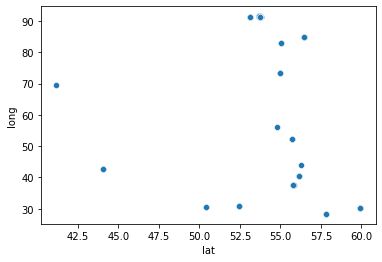

In [11]:
sns.scatterplot(x = data_full.loc[:, 'lat'], y = data_full.loc[:, 'long']);

Посмотрим, откуда они по мнению гугл карт. Набор внушительный, от Узбекистана до Київа.

In [12]:
pd.Series(data_full.loc[data_full.long<90, 'address'].unique()).apply(geolocator)

0     (ул. Кирова 29, Гомель, Беларусь, (52.4313771,...
1     (ул. Арбат, 2 корпус 1, Москва, Moscow Oblast,...
2     (ул. Маршала Жукова, 21, Омск, Омская обл., Ро...
3     (ул. Некрасова, 39, Санкт-Петербург, Россия, 1...
4     (ул. Крылова, 48, Новосибирск, Новосибирская о...
5     (3 Pushkin st., Krasnogorsk, Узбекистан, (41.1...
6     (ул. Арбат, 2, Москва, Россия, 119019, (55.752...
7     (пр. Ленина, 54, Томск, Томская обл., Россия, ...
8     (ул. Вокзальная, 12, Владимир, Владимирская об...
9     (ул. Некрасова, 45, Псков, Псковская обл., Рос...
10    (пр. Дружбы Народов, 41/09Б, Набережные Челны,...
11    (ул. Вокзальная, 16, Ессентуки, Ставропольский...
12    (бульвар Дружби Народів, 43, Київ, Украина, 02...
13    (ул. Академика Комарова, 5 корпус 1, Москва, Р...
14    (ул. Некрасова, д.37, Санкт-Петербург, Россия,...
15    (ул. Маршала Жукова, 17, Уфа, Респ. Башкортост...
16    (ул. Некрасова, 41, Новосибирск, Новосибирская...
17    (пр. Ленина, 56, Сургут, Ханты-Мансийский 

Скорее всего, дело в том, что у этих объектов в адресе не указан город, поэтому пройдемся по ним заново, на этот раз добавляя перед адресом название города.

Wall time: 1min 35s


<AxesSubplot:xlabel='lat', ylabel='long'>

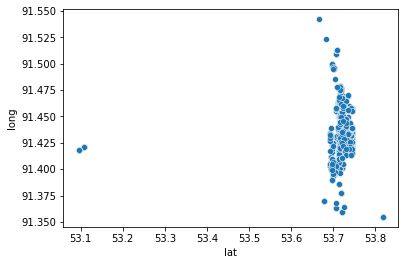

In [13]:
%%time
a = pd.Series(data_full.loc[data_full.long<90, 'address'].unique()).apply(lambda x: 'Абакан, ' + x).apply(geolocator)
aa = pd.DataFrame(data_full.loc[data_full.long<90, 'address'].unique(), columns = ['address'])
aa['ggl_address'] = a.apply(lambda x: [x.latitude, x.longitude])
for k in aa.address:
    data_full.loc[data_full.address == k, 'lat'] = aa.loc[aa.address == k, 'ggl_address'].values[0][0]
    data_full.loc[data_full.address == k, 'long'] = aa.loc[aa.address == k, 'ggl_address'].values[0][1]

sns.scatterplot(x = data_full.loc[:, 'lat'], y = data_full.loc[:, 'long']);

Смотрим на недочеты.

In [14]:
data_full.loc[data_full.lat < 53.5, 'address']

401          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
402          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
403          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
404          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
405          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
406          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
407          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
408          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
409          Хакасия респ., Абакан, ул. Ивана Ярыгина, 26
412          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
413          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
414          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
415          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
416          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
417          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
418          Хакасия респ., Абакан, ул. Ивана Ярыгина, 32
2412    Республика Хакасия, Абакан, ул. Ивана Ярыгина, 21
2600    Респуб

Поправляем руками.

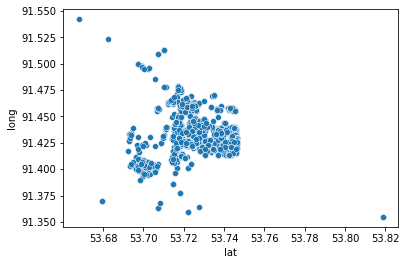

In [15]:
data_full.loc[data_full.address == 'Хакасия респ., Абакан, ул. Ивана Ярыгина, 26', 'lat'] = 53.721697
data_full.loc[data_full.address == 'Хакасия респ., Абакан, ул. Ивана Ярыгина, 26', 'long'] = 91.433373
data_full.loc[data_full.address == 'Хакасия респ., Абакан, ул. Ивана Ярыгина, 32', 'lat'] = 53.724500 
data_full.loc[data_full.address == 'Хакасия респ., Абакан, ул. Ивана Ярыгина, 32', 'long'] = 91.432760
data_full.loc[data_full.address == 'Республика Хакасия, Абакан, ул. Ивана Ярыгина, 21', 'lat'] = 53.726734
data_full.loc[data_full.address == 'Республика Хакасия, Абакан, ул. Ивана Ярыгина, 21', 'long'] = 91.431354 

sns.scatterplot(x = data_full.loc[:, 'lat'], y = data_full.loc[:, 'long']);

И еще раз. Заканчиваем на этом, все остальное - Абакан.

In [17]:
data_full.loc[data_full.lat > 53.76, 'address']

192     Хакасия респ., Абакан, ул. Генерала Тихонова, 2
2534                        ул. Генерала Тихонова, д. 2
2974                        ул. Генерала Тихонова, д. 2
Name: address, dtype: object

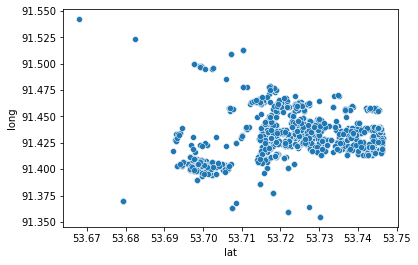

In [20]:
data_full.loc[data_full.lat > 53.76, 'lat'] = 53.730156
data_full.loc[data_full.lat > 53.76, 'long'] = 91.412155
sns.scatterplot(x = data_full.loc[:, 'lat'], y = data_full.loc[:, 'long']);

## Работа с картой

Ресурс **[OpenStreetMap](https://www.openstreetmap.org/)** предлагает довольно детальную карту города с описанием огромного числа всевозможных объектов, начиная от светофоров, пешеходных переходов и деревьев, заканчивая зданиями и различными объектами инфраструктуры. Но работать с выгружаемой оттуда картой не очень удобно, так как ее формат (*osm.pbf*) требует использования дополнительных пакетов, поэтому будем пользоваться следующим аналогом: **[Bbike](https://extract.bbbike.org/)**, откуда можно загрузить идентичную карту в любом из привычных форматов на выбор, выбирать будем *GeoJSON*.

Получается довольно внушительный датасет с чуть менее 66000 строк и 335 столбцами. С 0 по 333 стобцы расположены описания объектов, в последней колонке (*geometry*) геометрическое представление объектов, выраженное через *Point/LineString/Multipolygon*.

In [21]:
abakan.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 65965 entries, 0 to 65964
Columns: 336 entries, crossing to geometry
dtypes: geometry(1), object(335)
memory usage: 169.1+ MB


Посмотрим на карту города с выделенными на ней красными точками адресами объявлений о продаже квартир, за исключением тех объектов, где не указан номер дома.

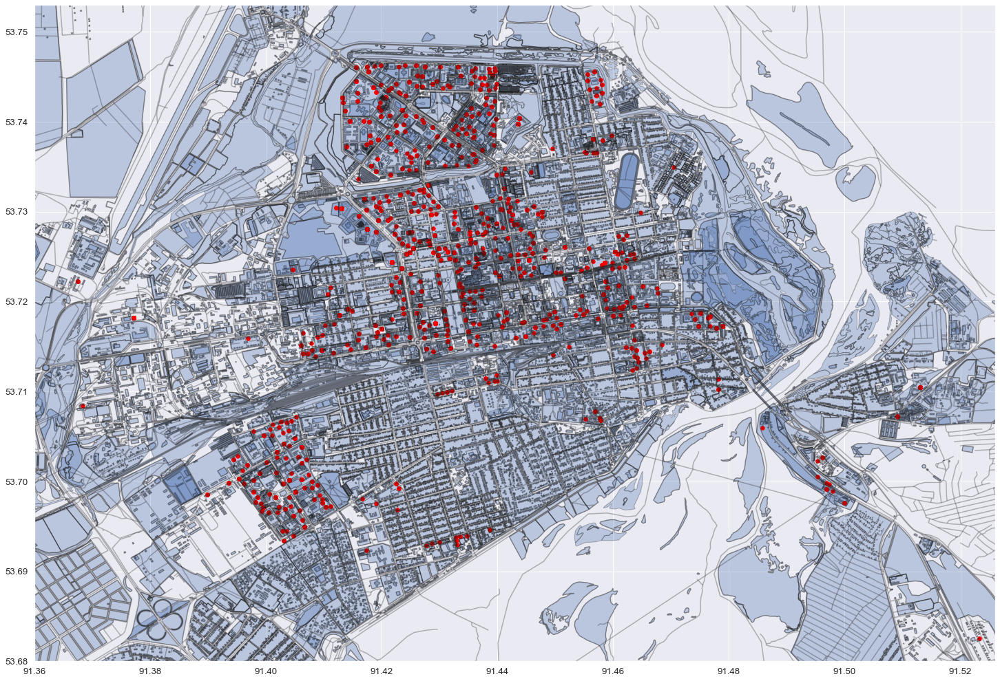

In [40]:
ax = abakan.plot(figsize = (25,25), alpha = 0.3, edgecolor = 'k', markersize = 0.001)
geopandas.GeoSeries(data_full.loc[data_full.number != '0', :].apply(lambda x: Point(x['long'], x['lat']), axis = 1)) \
.plot(ax = ax, color = 'red', markersize = 30)
ax.set_aspect(1/math.cos(math.radians(50.0)))
ax.set_xlim(91.36, 91.526)
ax.set_ylim(53.68, 53.753)
plt.show()

В данных есть некоторая информация о делении города на районы, представленная в столбце *landuse*. Визуализируем ее на карте. Некоторые пояснения (в скобках указаны соответствующие описываемым областям тэги):
* Большая часть объявлений находятся на **желтых** участках карты - это земли, на которых могут распологаться жилые дома (*residential*)
* **Фиолетовые** участки - промышленные зоны (*industrial*)
* **Синие** и **зеленые** участки - зоны, покрытые травой, и гаражные зоны соответственно (*grass/garages*)

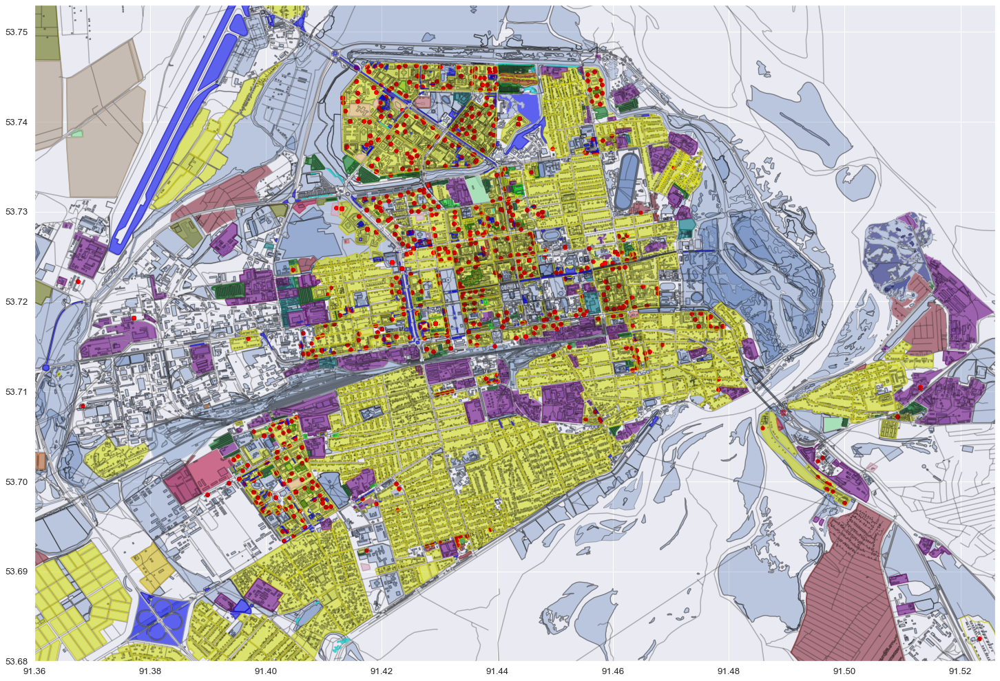

In [41]:
c_count = 0
ax = abakan.plot(figsize = (25,25), alpha = 0.3, edgecolor = 'k', markersize = 0.001)
for i in abakan[abakan.landuse.notnull()]['landuse'].unique():
    geopandas.GeoDataFrame(abakan[(abakan.landuse == i)]) \
    .plot(ax = ax, color = colors_s[c_count], markersize = 15, alpha = 0.5)
    c_count += 1
geopandas.GeoSeries(data_full.loc[data_full.number != '0', :].apply(lambda x: Point(x['long'], x['lat']), axis = 1)) \
.plot(ax = ax, color = 'red', markersize = 30)
ax.set_aspect(1/math.cos(math.radians(50.0)))
ax.set_xlim(91.36, 91.526)
ax.set_ylim(53.68, 53.753)
plt.show()

Рассмотрим подробнее жилые земли (*landuse == residential*), они подразумевают некоторое административно-территориальное деление, при этом между собой районы делятся на три вида (на карте ниже):
* **Синие** - районы с многоквартирной застройки (*urban*)
* **Зеленые** - районы частной застройки (*rural*)
* **Желтые** - неразмеченные районы (*None*)

Как можно заметить, часть объявлений не попадают ни в одну из перечисленных зон, что, может быть связано как с тем, что квартиры в этих объявлениях находятся на стадии строительства в расширяющихся районах города, еще не занесенных на карту в osm, так и с ошибками в адресах.

Кажется, что нет смысла разбивать объявления на категории по конкретным жилищным районам, так как всего их более 1500 единиц (большая часть из которых, вероятно, представлена в выборке), что на нашем скромном датасете в 3300 строк, скорее всего, быстро приведет к переобучению. Но попробуем позже добавить хотя бы категорию земель из числа перечисленных выше, на которых находится конкретный адрес.

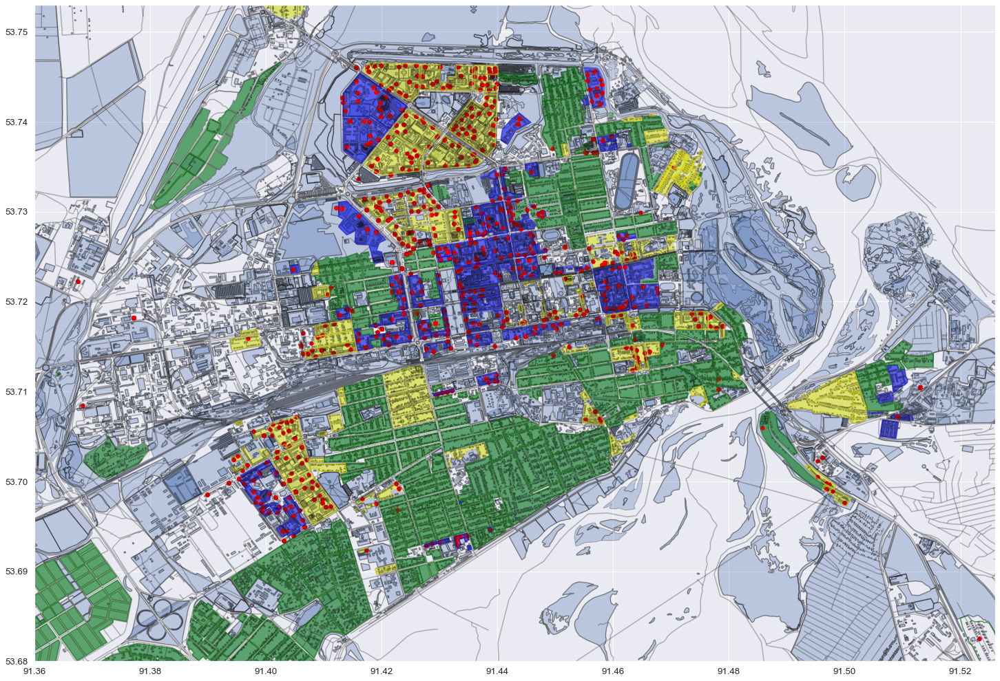

In [42]:
ax = abakan.plot(figsize = (25,25), alpha = 0.3, edgecolor = 'k', markersize = 0.001)
geopandas.GeoDataFrame(abakan[(abakan.landuse == 'residential') & (abakan.residential == 'urban')]) \
.plot(ax = ax, color = 'blue', markersize = 15, alpha = 0.5)
geopandas.GeoDataFrame(abakan[(abakan.landuse == 'residential') & (abakan.residential == 'rural')]) \
.plot(ax = ax, color = 'green', markersize = 15, alpha = 0.5)
geopandas.GeoDataFrame(abakan[(abakan.landuse == 'residential') & (abakan.residential.isnull())]) \
.plot(ax = ax, color = 'yellow', markersize = 15, alpha = 0.5)
geopandas.GeoSeries(data_full.loc[data_full.number != '0', :].apply(lambda x: Point(x['long'], x['lat']), axis = 1)) \
.plot(ax = ax, color = 'red', markersize = 30)
ax.set_aspect(1/math.cos(math.radians(50.0)))
ax.set_xlim(91.36, 91.526)
ax.set_ylim(53.68, 53.753)
plt.show()

## Подготовка признаков

Исходя из предоставленной в датасете, описывающем город, информации, появляется возможность построить следующие признаки (в скобках указаны соответствующие столбцы в датафрейме *abakan* или значения в столбцах, идентифицирующие искомые объекты):
1. Количество объектов типа x в радиусе **100, 500, 1000** метров (расматривался также вариант с радиусами 250 и 750 метров, но данные по объектам в окружностях такого радиуса чересчур коррелируют с данными в 500 и 500/1000-метровых радиусах соответственно), в качестве x будем брать следующие элементы карты (через дефис написаны наименования будущих переменных, там, где они не указаны, наименования будут выглядеть как *'имя в скобках'_points*):
    * объекты досуга (*leisure*) 
    * магазины (*shop*) 
    * объекты удобства (*amenity*) 
    * безопасные пересечения проезжих частей (*crossing*)
    * автобусные оставновки (*'platform'* в *public_transport* | *'bus_stop' в highway*) - bus_points
    * объекты природы (*natural*)
    * спортивные объекты (*sport*) 
    * все здания (*building*) 
    * медицинские учреждения и аптеки(*'hospital', 'dentist', 'doctors', 'clinic', 'pharmacy'* в *amenity* | *healthcare*) - healthcare_points
    * исторические объекты (*historic*) 
    * туристические объекты (*tourism*)
    * отели (*'hotel'* в *tourism*) - hotel_points
    * офисы (*office*)
    * парковки (*'parking'* в *amenity*) - parking_points
    * точки общественного питания (*'cafe', 'restaurant', 'fast_food', 'pub', 'bar'* в *amenity*) - catering_points
    * детские сады и учебные заведения (*'school', 'kindergarten', 'college', 'university'* в *amenity*) - study_points
  
  
2. Расстояние в километрах до объекта типа x, где x (у последних двух строим для каждого уникального адреса квартир расстояния до всех возможных объектов и выбираем минимальное):

    * географический центр города (*'city'* в *place*)
    * ближайшая автобусная остановка (в Абакане из общественного транспорта есть только *автобусы/троллейбусы/маршрутки*)
    * ближайший безопасный переход через проезжую часть
    
    
3. Принадлежность адреса к определенному типу земель (еще раз взглянуть на которые можно на предыдущем графике), определяющуюся следующим образом:

    * районы c многоквартирными домами (*'residential'* в *landuse* и *'rural'* в *residential*)
    * районы с частными домами (*'residential'* в *landuse* и *'rural'* в *residential*)
    * неразмеченные районы (*'residential'* в *landuse* и *'None'* в *residential*)
    * остальные районы (*все, что не попало ни в одну из предыдущих категорий*)
    
Осуществлять представленное в первом пункте будем с помощью функции **find_objects**, в которой на вход подается датафрейм с координатами и искомым радиусом, на выходе получаем датафрейм с наваренными для этих координат фичами. 

Функция специально разделена по радиусам окружности (очевидно, что можно было создать функцию без указания радиуса, уместив все три числа в цикле внутри нее), так как процесс построения окружностей, поиска пересечений с полигонами и хранения этой информации занимает много оперативной памяти, что нередко может приводить к смерти процесса.

Общее время ожидания порядка 3 часов, специально оставляю закомменченой загрузку в ноутбук всех трех файлов с готовыми признаками, чтобы не повторять долгий процесс, который даже с разделением на три части периодически выносит мне ноутбук (вполне вероятно, что написанный мною код слишком индусский, и выполнить ту же задачу можно в разы быстрее и без огромных вычислительных затрат).

In [43]:
%%time
osm_features001 = data_full[['lat', 'long']].dropna(axis = 0).drop_duplicates() \
.apply(find_objects, **{'h': 0.001}, axis = 1)
osm_features005 = data_full[['lat', 'long']].dropna(axis = 0).drop_duplicates() \
.apply(find_objects, **{'h': 0.005}, axis = 1)
osm_features01 = data_full[['lat', 'long']].dropna(axis = 0).drop_duplicates() \
.apply(find_objects, **{'h': 0.01}, axis = 1)

# osm_features001 = pd.read_excel('osm_features001.csv', index_col = 0)
# osm_features005 = pd.read_excel('osm_features005.csv', index_col = 0)
# osm_features01 = pd.read_excel('osm_features01.csv', index_col = 0)

Объединяем полученные для первого пункта признаки и создаем те, что описаны во втором и третьем пунктах предыдущего текста, заливая все это в наш старый датафрейм.

In [44]:
%%time
osm_features = osm_features001.join(osm_features005.drop(['lat', 'long'], axis = 1)) \
.join(osm_features01.drop(['lat', 'long'], axis = 1))

# Расстояние до географического центра города (Важно! Координаты должны быть в последовательности (lat, long))
osm_features['center_dist'] = osm_features[['lat', 'long']] \
.apply(lambda x: geopy.distance.geodesic((x.lat, x.long), (abakan[abakan.place == 'city'].geometry.y.values[0], \
abakan[abakan.place == 'city'].geometry.x.values[0])).kilometers, axis = 1)

# Расстояние до ближайшей автобусной остановки (--//--)
osm_features['bus_stop_dist'] = osm_features[['lat', 'long']] \
.apply(lambda x: np.min([geopy.distance.geodesic((x.lat, x.long), (g.centroid.y, g.centroid.x)).kilometers \
for g in abakan[(abakan.public_transport == 'platform') | (abakan.highway == 'bus_stop')].geometry]), axis = 1)

# Расстояние до ближайшего перехода через проезжую часть (--//--)
osm_features['crossing_dist'] = osm_features[['lat', 'long']] \
.apply(lambda x: np.min([geopy.distance.geodesic((x.lat, x.long), (g.centroid.y, g.centroid.x)).kilometers \
for g in abakan[abakan['crossing'].notnull()].geometry]), axis = 1)

# Категория земель, на которых находится дом (--//--)
osm_features['area'] = osm_features[['lat', 'long']].apply(region_finder, axis = 1)

data_full = pd.merge(data_full, osm_features, on = ['lat', 'long'])

Wall time: 5min 28s


Посмотрим на гистограммы распределения полученных признаков. Бросается в глаза обилие нолей в представленных данных, особенно для радиуса в 100 метров.

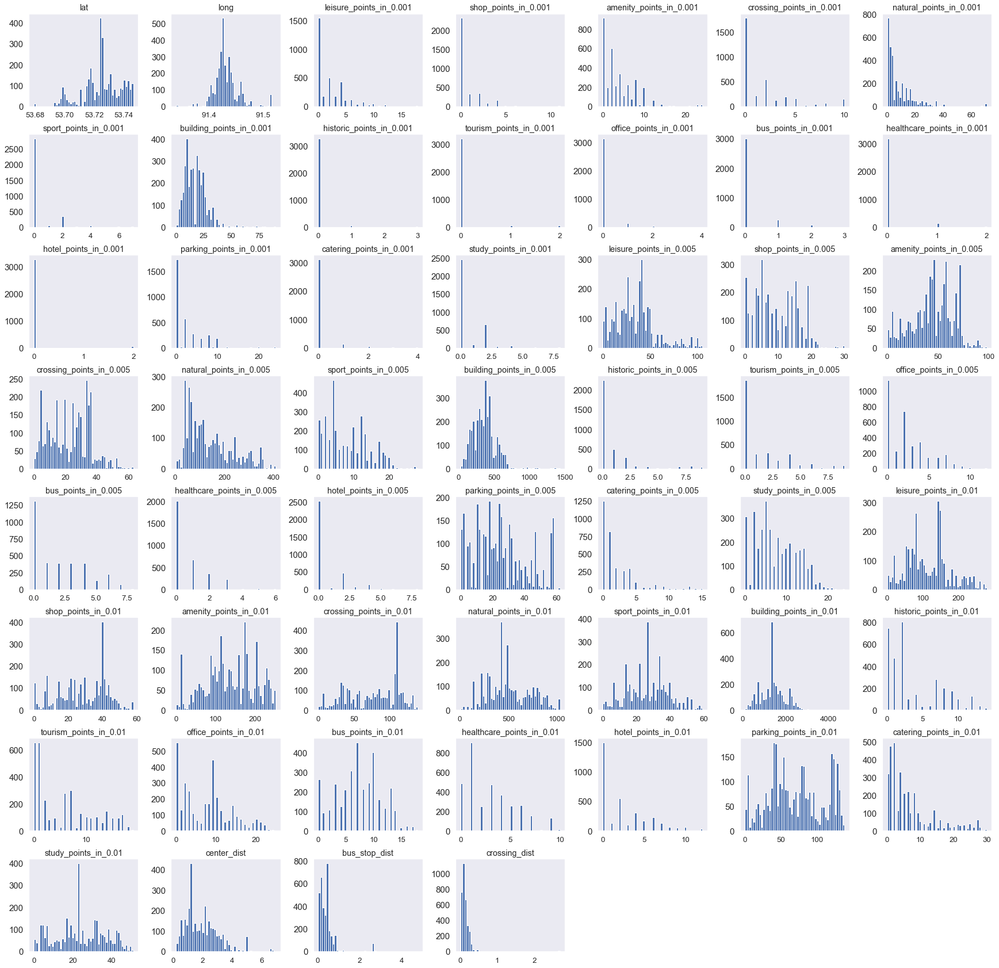

In [45]:
data_full.iloc[:, 35:-1].hist(figsize = (30,30), bins = 50, grid = False, ylabelsize = 15);

Взглянем на корреляции полученных признаков по радиусам. Сразу заметны высокие коэффициенты между отелями и туристическими объектами, парковками и объектами удобства, что очевидно связано с тем, что первые являются частью выборки вторых для каждой пары соответственно. Тоже самое можно наблюдать с точками общепита и объектами удобства, учебными заведениями и объектами удобства с ростом радиуса выстраиваемой вокруг недвижимости окружности.

Также заметны отрицательные корреляции почти всех переменных, связанных с количествами объектов в радиусе, и расстоянием до географического центра города. Особенно высоки они у объектов досуга и безопасных пересечений проезжей части. Здесь нет ничего необычного, очевидно, что чем дальше адрес от центра, тем, как правило, меньше разных объектов рядом с ним.

В целом корреляции сильно растут при переходе к километровому радиусу, который может быть слишком большим для такого небольшого города, и получается так, что множество построенных вокруг адресов окружностей просто накрывают центр города, где представлена существенная часть объектов из всевозможных категорий.

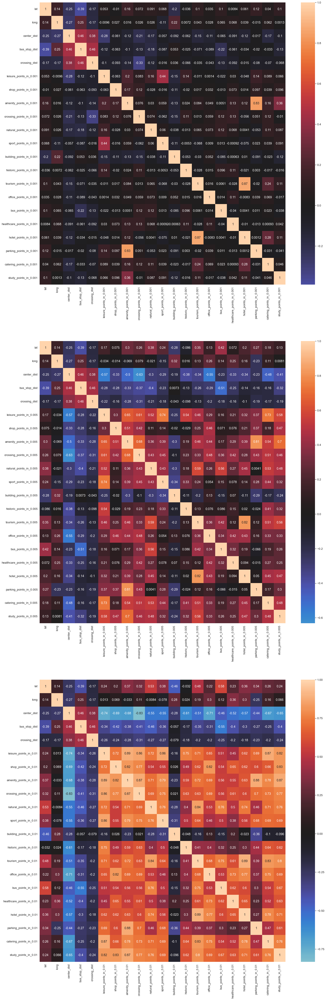

In [46]:
fig, ax = plt.subplots(nrows = 3, ncols = 1, figsize = (25,80))
sns.set(font_scale=1.2)
sns.heatmap(osm_features.loc[:, ['lat', 'long', 'center_dist', 'bus_stop_dist', 'crossing_dist', 'area'] + \
osm_features.columns[osm_features.columns.str.contains('0.001')].tolist()].corr(), annot = True, ax = ax[0], center=0);
sns.heatmap(osm_features.loc[:, ['lat', 'long', 'center_dist', 'bus_stop_dist', 'crossing_dist', 'area'] + \
osm_features.columns[osm_features.columns.str.contains('0.005')].tolist()].corr(), annot = True, ax = ax[1], center=0);
sns.heatmap(osm_features.loc[:, ['lat', 'long', 'center_dist', 'bus_stop_dist', 'crossing_dist', 'area'] + \
osm_features.columns[osm_features.columns.str.contains('0.01')].tolist()].corr(), annot = True, ax = ax[2], center=0);
plt.show()

У подхода с географическими признаками видится один недостаток. У части объявлений в адресе не был указан номер дома, гугл при кодировании таких адресов выдает какую-то условно случайную точку на улице, которая указана в адресе. Таких объявлений набирается порядка 600 с общим числом уникальных адресов чуть более 60. Естественно, географические признаки для них, к сожалению, не несут никакого смысла, но совсем расставаться с такой значительной частью выборки не хочется. Попробуем создать дамми на то, был ли у адреса на самом деле номер дома, возможно будущим моделям будет достаточно этой информации для адекватного применения созданных здесь фичей. А если нет, то придется выкидывать объекты без номера дома.

In [47]:
data_full['number_missing'] = 0
data_full.loc[data_full.number == '0', 'number_missing'] = 1

## Кластеризация объявлений

Желание провести кластеризацию появляется из-за невозможности вытащить адекватное административно-территориальное деление из карты города в предыдущем пункте. Все-таки хочется увидеть, каким образом можно разбить город на некоторые районы, и попроверять гипотезы о разности цен объявлений между полученными зонами.

Долго размышлял над тем, нужно ли проводить кластеризацию только с учетом *уникальных* адресов, или же стоит рассматривать все адреса *с повторениями* в том числе, если задачей является разбиение города на оптимальное число районов в случае, когда для такого разбиения используются только *широта* и *долгота*.

С одной стороны кажется, если дом характеризуется конкретным значением координат, то не имеет смысла многократно повторять их в выборке, тем самым искуственно повышая плотность точки и как бы создавая кластер там, где его может и не быть (выборка все-таки случайная, и в любом соседнем доме может быть столько же квартир, но меньше выставленных на продажу объявлений).

Однако в новых или строящихся районах, скорее всего, не так много построенных домов, но существует значительное число объявлений о продаже квартир внутри одного дома. Тогда добавление в выборку повторяющихся координат позволит легче определять такие кластеры.

Оба суждения могут оказаться неверными, или же неправильной будет логика моего обоснования их правильности, так что кластеризацию будем проводить для двух случаев (не забывая убирать из выборки наблюдения, где не указан номер дома): 
* **С уникальными значениями координат**
* **С повторяющимися значениями координат**

### K-means

Начнем с простого k-means, если в достоверности его разделения будут сомнения, перейдем к чему-то посложнее. Оценивать разбиения будем не только визуально, но и с помощью следующих метрик (*дисклеймер*: ни одна из них не предназначена для сравнения разных алгоритмов/датасетов, данные метрики применимы для сравнения оценок кластеризации для конкретного набора данных, полученных при различных значениях гиперпараметров):
* **inertia**
* **silhouette_score**

Почитать про них можно [здесь](https://scikit-learn.org/stable/modules/clustering.html).

Переберем число кластеров от 2 до 30.

In [48]:
%%time
# Фреймы, включающие только объявления с полными адресами: osm_nonull для уникальных, data_nonull для повторяющихся адресов
osm_nonull = osm_features.loc[np.sort(list(set(osm_features.index) - set(data_full.loc[data_full.number == '0', \
                                                                                       ['lat', 'long']].index))), :].copy()
data_nonull = data_full.loc[data_full.number != '0', :].copy()

inert = []
inert1 = []
insta = []
insta1 = []
for i in range(2, 30):  
    instance = KMeans(n_clusters=i, random_state = 42)
    instance.fit(osm_nonull[['lat', 'long']])
    inert.append(instance.inertia_)
    insta.append(silhouette_score(osm_nonull[['lat', 'long']], instance.labels_))
    
    instance1 = KMeans(n_clusters=i, random_state = 42)
    instance1.fit(data_nonull[['lat', 'long']])
    inert1.append(instance1.inertia_)
    insta1.append(silhouette_score(data_nonull[['lat', 'long']], instance1.labels_))

Wall time: 10.9 s


График для inertia выглядит следующим образом.

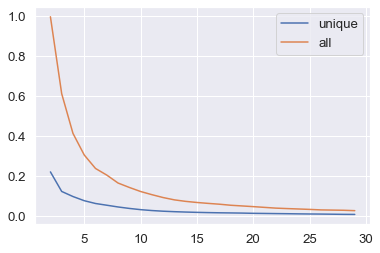

In [49]:
sns.lineplot(x = range(2, 30), y = inert, label = 'unique');
sns.lineplot(x = range(2, 30), y = inert1, label = 'all');

Этот для silhouette_score. Примечателен тот факт, что для уникальных значений silhouette_score колеблется на уровне ~0.425 для числа кластеров больше 30 с небольшим убывающим трендом, тогда как для повторяющихся значений на том же промежутке появляется заметный возрастающий тренд, доходящий до ~0.65 при числе кластеров, равном 100. 

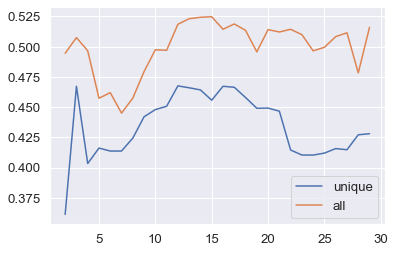

In [50]:
sns.lineplot(x = range(2, 30), y = insta, label = 'unique');
sns.lineplot(x = range(2, 30), y = insta1, label = 'all');

Однако разбиения на 30+ кластеров при повторяющихся адресах выглядят ну уж совсем неадекватно на картинках. Кажется, что k-means просто начинает находить кластеры в домах, где есть много объявлений о продаже квартир, о чем упоминалось в обсуждении того, нужно ли включать повторяющиеся значения.

Оптимальное чило кластеров по метрике *inertia* определяется при помощи т.н. *'elbow method'*: на графике зависимости метрики от числа кластеров ищем некую точку перегиба, где прирост числа кластеров переходит от значительного снижения метрики к незначительному снижению. Очевидно, что в зависимости от степени воображения, эта точка может находиться в интервале от 5 до 10, в чем и состоит основной недостаток метода.

*Silhouette_score* лишен такой неоднозначности, максимальные значения для уникальных адресов 0.46723, 0.46759 и 0.46726 (метрика принимает значения в интервале (-1; 1)) наблюдаются при числе кластеров, равном **3**, **12** и **16** соответственно. Для повторяющихся адресов максимальные значения метрики в пределах 30 кластеров: 0.5243 и 0.5247 для разбиений на **14** и **15** зон соответственно.

Посмотрим на представленные разбиения, в левом столбце нарисована кластеризация для уникальных значений адресов, в правом - для повторений, красным цветом отмечены названия графиков, где метрика *silhouette_score* принимает большие значения, ее значения также представлены в названии.

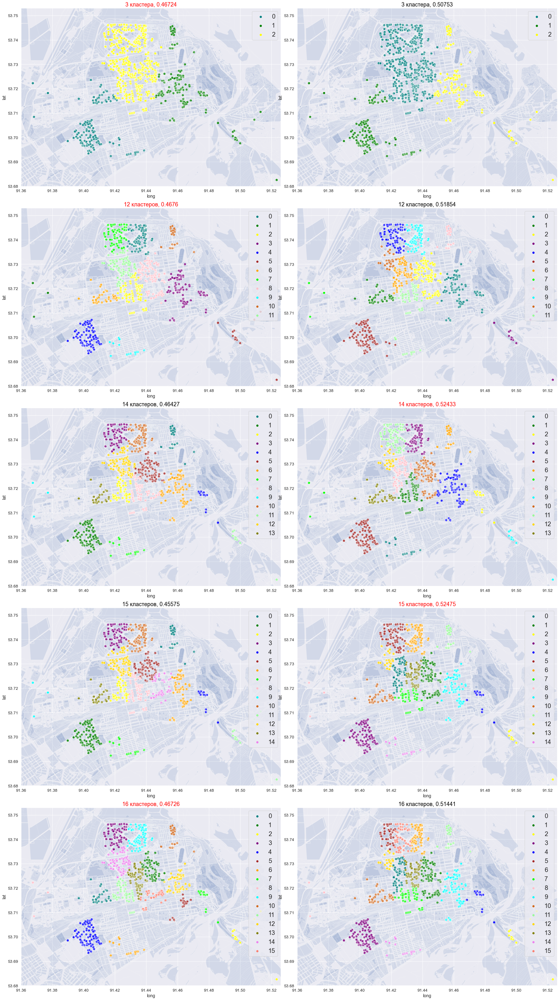

In [51]:
# Лучшие разбиения
for i in [3, 12, 14, 15, 16]:
    instance = KMeans(n_clusters = i, random_state = 42)
    instance1 = KMeans(n_clusters = i, random_state = 42)
    instance.fit(osm_nonull.loc[:, ['lat', 'long']])
    instance1.fit(data_nonull.loc[:, ['lat', 'long']])
    data_nonull[f'unique_cl{i}'] = instance.predict(data_nonull.loc[:, ['lat', 'long']])
    data_nonull[f'all_cl{i}'] = instance1.predict(data_nonull.loc[:, ['lat', 'long']])

fig, ax = plt.subplots(nrows = 5, ncols = 2, figsize = (25, 45))
fig.tight_layout()

cl_count = 0
for i in [3, 12, 14, 15, 16]:
    abakan.plot(alpha = 0.15, edgecolor = 'white', markersize = 0.001, ax = ax[cl_count, 0])
    abakan.plot(alpha = 0.15, edgecolor = 'white', markersize = 0.001, ax = ax[cl_count, 1])

    sns.scatterplot(x = data_nonull.long, y = data_nonull.lat, hue = data_nonull[f'unique_cl{i}'], \
                    ax = ax[cl_count, 0], palette = sns.color_palette(colors_s, i), s = 60);
    
    sns.scatterplot(x = data_nonull.long, y = data_nonull.lat, hue = data_nonull[f'all_cl{i}'], \
                    ax = ax[cl_count, 1], palette = sns.color_palette(colors_s, i), s = 60);
    score_km = round(insta[i-2], 5)
    score_km1 = round(insta1[i-2], 5)
    
    if i in [3, 12, 16]:
        cl_colour = 'red'
    else:
        cl_colour = 'black'
    if i == 3:
        ax[cl_count, 0].set_title(f'{i} кластера, {score_km}', fontsize = 18, color = cl_colour)
    else:
        ax[cl_count, 0].set_title(f'{i} кластеров, {score_km}', fontsize = 18, color = cl_colour)
    ax[cl_count, 0].set_aspect(1/math.cos(math.radians(50.0)))
    ax[cl_count, 0].set_xlim(91.36, 91.526)
    ax[cl_count, 0].set_ylim(53.68, 53.753)
    ax[cl_count, 0].legend(fontsize = 20)
    
    if i in [14, 15]:
        cl_colour0 = 'red'
    else:
        cl_colour0 = 'black'
    if i == 3:
        ax[cl_count, 1].set_title(f'{i} кластера, {score_km1}', fontsize = 18, color = cl_colour0)
    else:
        ax[cl_count, 1].set_title(f'{i} кластеров, {score_km1}', fontsize = 18, color = cl_colour0)
    ax[cl_count, 1].set_aspect(1/math.cos(math.radians(50.0)))
    ax[cl_count, 1].set_xlim(91.36, 91.526)
    ax[cl_count, 1].set_ylim(53.68, 53.753)
    ax[cl_count, 1].legend(fontsize = 20)
    cl_count += 1
plt.show()

С тремя кластерами все просто, k-means делит город на три районы: западный, центральный и восточный, но границы этих районов выглядят не очень убедительно, помимо этого некоторые наблюдения дальше от центра явно должны иметь собственные кластеры. 

Среди уникальных значений мне больше всего импонирует разбиение на 12 кластеров, кажется, что в нем центральная область наиболее аккуратно делится на 5 районов, создавая логичные границы. Западная и восточная области также разбиваются на 4 и 3 области в соответствии с визуально разделимыми скоплениями точек.

Для повторяющихся значений сложно однозначно выбрать лучшее между 15 и 16, часть классов кажутся уж слишком вытянутыми по широте (ось Y).

#### Проверка гипотез

Проверим, существует ли разница в цене квартир между выделенными алогритмом районами.

Сначала посмотрим, соовпадают ли рапределения цены *уникальных* и *повторяющихся* объявлений с распределением цены всех объявлений. Обе гипотезы не отвергаются, так что дальнейшую проверку гипотез будем проводить с помощью t-теста (обоснованность его использования для цен обсуждалась в предыдущем ноутбуке).

In [52]:
print('H0: распределения всех цен и цен квартир с номерами в адресах для повторяющихся адресов совпадают, p-value: ', \
      round(scipy.stats.ks_2samp(data_full.price, data_nonull.price)[1], 4), '\n' \
      'H0: распределения всех цен и цен квартир с номерами в адресах для уникальных адресов совпадают, p-value: ', \
      round(scipy.stats.ks_2samp(data_full.price, data_full.loc[osm_nonull.index, 'price'])[1], 4))

H0: распределения всех цен и цен квартир с номерами в адресах для повторяющихся адресов совпадают, p-value:  0.559 
H0: распределения всех цен и цен квартир с номерами в адресах для уникальных адресов совпадают, p-value:  0.5967


##### 3 кластера
Сравним цены для разбиения на **3** кластера (здесь и далее предполагаются разбиения для *уникальных* адресов, если не указано иначе). Логично предположить, что цены в центральном кластере должны быть выше цен в двух остальных, так что в первых двух тестах альтернативная гипотеза состоит в том, что цены в центральном районе выше.

Первые две гипотезы отвергаются, третья нет, значит цены в центральном районе действительно выше, чем в остальных. Восточный и западный между собой не отличаются.

In [53]:
print('H0: цены в западном и центральном районах совпадают, p-value: ', \
      round(scipy.stats.ttest_ind(data_nonull.loc[data_nonull['unique_cl3'] == 2, 'price'], \
                                  data_nonull.loc[data_nonull['unique_cl3'] == 1, 'price'], \
                                  alternative = 'greater', equal_var = False)[1], 4), '\n' \
      'H0: цены в восточном и центральном районах совпадают, p-value: ', \
      round(scipy.stats.ttest_ind(data_nonull.loc[data_nonull['unique_cl3'] == 2, 'price'], \
                                  data_nonull.loc[data_nonull['unique_cl3'] == 0, 'price'], \
                                  alternative = 'greater', equal_var = False)[1], 4), '\n' \
      'H0: цены в восточном и западном районах совпадают, p-value: ', \
      round(scipy.stats.ttest_ind(data_nonull.loc[data_nonull['unique_cl3'] == 1, 'price'], \
                                  data_nonull.loc[data_nonull['unique_cl3'] == 0, 'price'], \
                                  alternative = 'two-sided', equal_var = False)[1], 4))

H0: цены в западном и центральном районах совпадают, p-value:  0.0 
H0: цены в восточном и центральном районах совпадают, p-value:  0.0 
H0: цены в восточном и западном районах совпадают, p-value:  0.271


##### 12 кластеров

Посмотрим на учатски в разбиении на **12** кластеров (В каждом случае нулевая гипотеза: равенство цен в двух кластерах, гипотезы здесь и далее не отвергаются для p-value > **0.05**), для удобства привожу простой график с разделением (здесь и далее на таких гарфиках представляются кластеры, для которых хоть раз не отверглась гипотеза о равенстве цен).

Гипотезы тестируем для всех пар кластеров.

In [54]:
hypo12 = hypothesis(12, 'unique')
hypo12.count_h()

'Всего будет протестировано 66 гипотез'

Однако на самом деле здесь важны только совпадения/различия в ценах тех зон, которые находятся недалеко друг от друга, так как мы проверям правильность кластеризации, поэтому важно, чтобы район разбивался на два и более кластеров только в случаях, когда цены в них окажутся разными.

Из примечательного, гипотезы о равенстве цен не отвергаются для **0** и **10** (бирюзовая и светло-зеленая верхние зоны), **2** и **6** (зеленая и синяя), **2**  и **11** (зеленая и розовая над ней), **3** и **10** (желтая и светло-зеленая), **6** и **11** (синяя и розовая) кластеров.

Цены в 0 и 2 не совпадают
Цены в 0 и 4 не совпадают
Цены в 0 и 6 не совпадают
Цены в 0 и 10 не совпадают
Цены в 0 и 11 не совпадают
Цены в 2 и 4 не совпадают
Цены в 2 и 6 не совпадают
Цены в 2 и 10 не совпадают
Цены в 2 и 11 не совпадают
Цены в 3 и 6 не совпадают
Цены в 3 и 10 не совпадают
Цены в 4 и 10 не совпадают
Цены в 6 и 10 не совпадают
Цены в 6 и 11 не совпадают
Цены в 7 и 8 не совпадают
Цены в 10 и 11 не совпадают


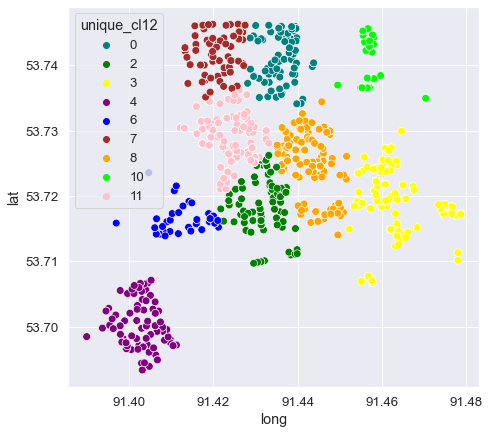

In [55]:
hypo12.notrej_h()
hypo12.notrej_zones()

Какие можно из этого сделать выводы?

Кластер **10** на самом деле не уникален, хотя визуально его действительно хочется выделить в отдельную зону.Судя по результатам сравнения цен, он должен быть присоединен или к кластеру **0**, или **3**.

Кластеры **2**, **6** и **11** тоже не уникальны, значимой разницы цен среди каждой пары из трех возможных найти не удалось.

Остальные разбиения, судя по всему, имеют смысл в разрезе разделения по ценам.

##### 14  кластеров

Теперь для **14** кластеров (с повторяющимися адресами)

In [58]:
hypo14 = hypothesis(14, 'all')
hypo14.count_h()

'Всего будет протестировано 91 гипотез'

Гипотезы о равенстве не отвергаются для **1** и **13** (бирюзовая и светло-голубая зоны), снова для **3** и **6** (темно-зеленая и синяя), вместе с **4**  и **6** (желтая и синеяя), **8** и **13** (темно-красная и светло-голубая в центре), **12** и **13** (светло-голубая и розовая) кластеров.

Здесь интересно появление нового кластера **12**, который значимо отличается от располагающегося над ним **11** и под ним **8**, но совпадает по ценам с **13**.

Цены в 1 и 3 не совпадают
Цены в 1 и 4 не совпадают
Цены в 1 и 5 не совпадают
Цены в 1 и 6 не совпадают
Цены в 1 и 12 не совпадают
Цены в 1 и 13 не совпадают
Цены в 3 и 4 не совпадают
Цены в 3 и 5 не совпадают
Цены в 3 и 6 не совпадают
Цены в 3 и 8 не совпадают
Цены в 3 и 12 не совпадают
Цены в 3 и 13 не совпадают
Цены в 4 и 6 не совпадают
Цены в 4 и 8 не совпадают
Цены в 4 и 12 не совпадают
Цены в 4 и 13 не совпадают
Цены в 5 и 6 не совпадают
Цены в 5 и 12 не совпадают
Цены в 6 и 8 не совпадают
Цены в 6 и 12 не совпадают
Цены в 6 и 13 не совпадают
Цены в 8 и 13 не совпадают
Цены в 10 и 11 не совпадают
Цены в 12 и 13 не совпадают


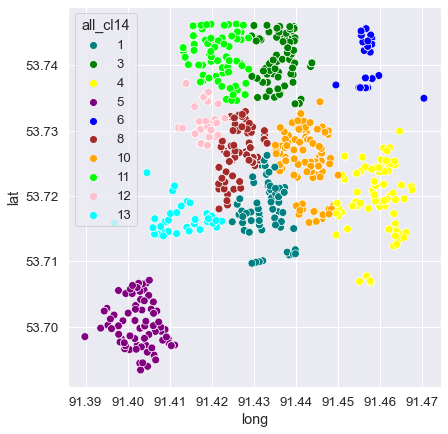

In [59]:
hypo14.notrej_h()
hypo14.notrej_zones()

##### 15  кластеров

Проделываем то же самое для **15** кластеров (теперь для повторяющихся значений). Для них гораздо хуже получается разделение центрального района, много гипотез для кластеров внутри него не отвергаются.

In [60]:
hypo15 = hypothesis(15, 'all')
hypo15.count_h()

'Всего будет протестировано 105 гипотез'

Цены в 0 и 6 не совпадают
Цены в 0 и 7 не совпадают
Цены в 0 и 9 не совпадают
Цены в 0 и 10 не совпадают
Цены в 0 и 11 не совпадают
Цены в 0 и 12 не совпадают
Цены в 1 и 5 не совпадают
Цены в 1 и 13 не совпадают
Цены в 3 и 6 не совпадают
Цены в 3 и 7 не совпадают
Цены в 3 и 11 не совпадают
Цены в 3 и 12 не совпадают
Цены в 5 и 13 не совпадают
Цены в 6 и 7 не совпадают
Цены в 6 и 9 не совпадают
Цены в 6 и 10 не совпадают
Цены в 6 и 11 не совпадают
Цены в 6 и 12 не совпадают
Цены в 7 и 10 не совпадают
Цены в 7 и 11 не совпадают
Цены в 7 и 12 не совпадают
Цены в 9 и 10 не совпадают
Цены в 9 и 11 не совпадают
Цены в 9 и 12 не совпадают
Цены в 10 и 11 не совпадают
Цены в 10 и 12 не совпадают
Цены в 11 и 12 не совпадают


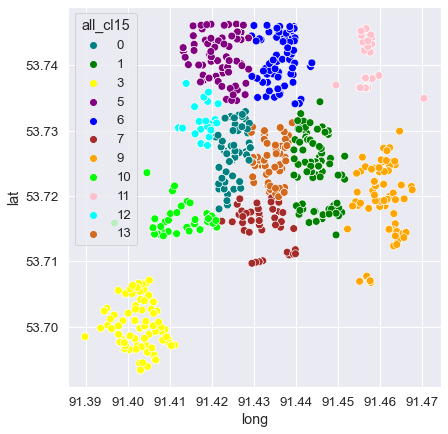

In [61]:
hypo15.notrej_h()
hypo15.notrej_zones()

##### 16  кластеров

**16** кластеров снова для уникальных значений. Тут выглядит довольно неплохо, большая часть гипотез не отвергается для отдаленных друг от друга кластеров, магическим образом пропадает зона **8** в самом центре, где отвергаются вообще все гипотезы, возможно это и есть тот самый центр города, значимо отличающийся от восточных, южных и западных около-центральных подзон.

In [62]:
hypo16 = hypothesis(16, 'unique')
hypo16.count_h()

'Всего будет протестировано 120 гипотез'

Цены в 0 и 7 не совпадают
Цены в 0 и 10 не совпадают
Цены в 0 и 11 не совпадают
Цены в 0 и 15 не совпадают
Цены в 1 и 3 не совпадают
Цены в 2 и 5 не совпадают
Цены в 4 и 9 не совпадают
Цены в 4 и 10 не совпадают
Цены в 4 и 12 не совпадают
Цены в 4 и 14 не совпадают
Цены в 4 и 15 не совпадают
Цены в 9 и 10 не совпадают
Цены в 9 и 11 не совпадают
Цены в 9 и 12 не совпадают
Цены в 9 и 14 не совпадают
Цены в 9 и 15 не совпадают
Цены в 10 и 11 не совпадают
Цены в 10 и 12 не совпадают
Цены в 10 и 14 не совпадают
Цены в 10 и 15 не совпадают
Цены в 11 и 12 не совпадают
Цены в 11 и 14 не совпадают
Цены в 11 и 15 не совпадают
Цены в 12 и 14 не совпадают
Цены в 12 и 15 не совпадают
Цены в 14 и 15 не совпадают


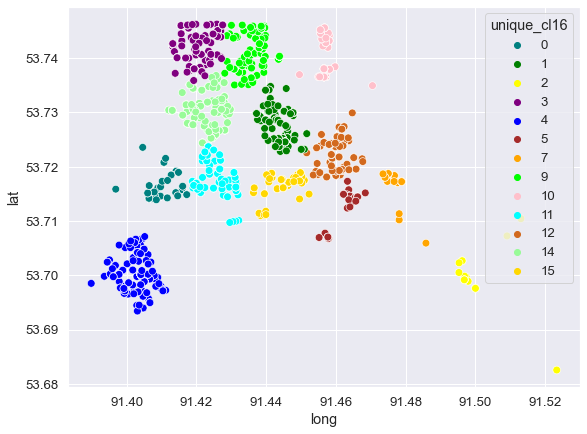

In [63]:
hypo16.notrej_h()
hypo16.notrej_zones()

Закончим с **k-means**, в целом часть разбиений выглядят неплохо, несмотря на не слишком высокие значения *silhouette_score* (~0.5), хотя некоторые кластеры в них и должны быть, судя по результатам тестирования, собраны в один. К разделению на 3 кластера никаких вопросов нет, но он получается уж слишком очевидным. Возможно, что-то более интересное смогут предложить плотностные алгоритмы, например, **dbscan**, к тому же он может успешно справиться с шумом, которого здесь, скорее всего, хватает даже с удалением адресов без номера дома.

### HDBSCAN

В качестве следующего алгоритма кластеризации применим старшего брата **DBSCAN** - иерархический DBSCAN или **HDBCSAN**. Его приоритет над предпоследним обусловлен более понятными гиперпараметрами: вместо не слишком интуитивной epsilon выбирается вполне доступный min_cluster_size - минимальное допустимое количество точек в кластере, а также возможностью делать предсказание на отложенной части выборки, что может помочь, если полученные разбиения на кластеры будут использоваться как признаки в модели, когда будет происходить деление на трейн и тест.

Так как алгоритм основан на оценке плотности и подразумевает нахождение шума в данных, метрики, используемые в предыдущем пункте для оценки полученных разбиений, здесь не подойдут. Вместо них будем опираться на *relative_validity_score* (принимает значения в интервале (-1; 1), почитать про метрику можно [здесь](https://www.dbs.ifi.lmu.de/~zimek/publications/SDM2014/DBCV.pdf)).

Переберем случайный набор параметров для уникальных и повторяющихся значений, фиксируя *relative_validity_score*, количество кластеров и число обнаруженных выбросов.

In [64]:
%%time
# HDBSCAN не требует фиксирования random_state, кластеризация будет одинаковой во всех случаях, когда данные на вход \
# подаются в одном и том же порядке

# С большим разбросом гиперпараметров
hdb_variants = pd.DataFrame({'min_samples' : np.random.RandomState(42).choice(range(4, 400, 4), 1000).astype(np.int64), \
                             'min_size' : np.random.RandomState(42).choice(range(5, 700, 10), 1000).astype(np.int64), \
                             'metric' : np.random.RandomState(42).choice(['euclidean','manhattan'], 1000), \
                             'score_all' : np.nan, \
                             'score_unique' : np.nan}) 
# С небольшим разбросом
hdb_variants1 = pd.DataFrame({'min_samples' : np.random.RandomState(42).choice(range(2, 21, 1), 1000).astype(np.int64), \
                             'min_size' : np.random.RandomState(42).choice(range(2, 31, 1), 1000).astype(np.int64), \
                             'metric' : np.random.RandomState(42).choice(['euclidean','manhattan'], 1000), \
                             'score_all' : np.nan, \
                             'score_unique' : np.nan})

hdb_variants = pd.concat([hdb_variants, hdb_variants1]).drop_duplicates().reset_index(drop = True)

for i in hdb_variants.index:  
    hdb = hdbscan.HDBSCAN(min_samples = int(hdb_variants.loc[i, 'min_samples']), \
                          min_cluster_size = int(hdb_variants.loc[i, 'min_size']), \
                          metric = hdb_variants.loc[i, 'metric'], \
                          gen_min_span_tree = True)
    
    hdb1 = hdbscan.HDBSCAN(min_samples = int(hdb_variants.loc[i, 'min_samples']), \
                           min_cluster_size = int(hdb_variants.loc[i, 'min_size']), \
                           metric = hdb_variants.loc[i, 'metric'], \
                           gen_min_span_tree = True)
    hdb.fit(osm_nonull.loc[:, ['lat', 'long']])
    hdb1.fit(data_nonull.loc[data_full.number != '0', ['lat', 'long']])
    
    hdb_variants.loc[i, 'score_unique'] = hdb.relative_validity_
    hdb_variants.loc[i, 'score_all'] = hdb1.relative_validity_
    hdb_variants.loc[i, 'n_unique'] = len(set(hdb.labels_))
    hdb_variants.loc[i, 'n_all'] = len(set(hdb1.labels_))
    hdb_variants.loc[i, 'outliers_unique'] = sum(hdb.labels_ == -1)
    hdb_variants.loc[i, 'outliers_all'] = sum(hdb1.labels_ == -1)

Wall time: 9min 11s


В результатах присутствуют разбиения с довольном большим скором (~0.76) как для уникальных, так и для повторяющихся значений. Проблема в том, что почти все из них предполагают огромное количество кластеров (от 60 до 380) и не менее значительное количество адресов (от 90 до 470), помеченных как шум, что не очень подходит под описание искомых результатов. Так что будем довольствоваться разделениями с меньшими значениями метрики, но адекватным числом кластеров и выбросов.

In [65]:
hdb_variants.loc[hdb_variants.loc[:, 'score_all'].nlargest(10).index \
.append(hdb_variants.loc[:, 'score_unique'].nlargest(10).index), :]

,min_samples,min_size,metric,score_all,score_unique,n_unique,n_all,outliers_unique,outliers_all
1089,2,2,euclidean,0.766884,0.193012,64.0,374.0,93.0,91.0
1042,2,3,euclidean,0.747958,0.196209,57.0,335.0,93.0,121.0
1612,2,2,manhattan,0.731534,0.254097,57.0,371.0,98.0,86.0
1051,2,3,manhattan,0.712055,0.198952,50.0,337.0,87.0,110.0
1445,3,2,euclidean,0.656642,0.173835,37.0,329.0,118.0,145.0
1088,2,4,euclidean,0.625299,0.185764,41.0,253.0,112.0,158.0
1545,3,2,manhattan,0.614012,0.173767,49.0,332.0,141.0,137.0
1162,4,2,euclidean,0.601573,0.031916,9.0,313.0,27.0,214.0
1149,4,3,euclidean,0.584104,0.076384,16.0,237.0,65.0,224.0
1166,4,4,euclidean,0.581086,0.031916,9.0,209.0,27.0,257.0


Ищем 5 лучших разбиений с числом кластеров менее 20 и количеством выбросов не более 40 для *уникальных значений*.

In [66]:
hdb_variants.loc[hdb_variants.loc[(hdb_variants.n_unique < 20) & \
                                  (hdb_variants.outliers_unique < 40), 'score_unique'].nlargest(10).index, :]

,min_samples,min_size,metric,score_all,score_unique,n_unique,n_all,outliers_unique,outliers_all
1072,5,10,euclidean,0.439593,0.768258,5.0,93.0,35.0,437.0
1173,5,13,euclidean,0.422736,0.768258,5.0,76.0,35.0,427.0
1460,5,11,euclidean,0.427244,0.768258,5.0,87.0,35.0,438.0
1555,5,14,euclidean,0.402931,0.768258,5.0,71.0,35.0,466.0
1313,5,4,euclidean,0.535276,0.155974,9.0,187.0,33.0,301.0
1325,5,2,euclidean,0.517027,0.155974,9.0,301.0,33.0,233.0
1520,5,3,euclidean,0.534203,0.155974,9.0,221.0,33.0,282.0
1154,3,7,manhattan,0.447931,0.152597,8.0,146.0,25.0,268.0
1332,4,16,euclidean,0.376217,0.147813,4.0,64.0,30.0,430.0
1386,4,17,euclidean,0.389784,0.147813,4.0,59.0,30.0,420.0


Таких оказывается несколько, выбираем лучшие.

In [67]:
hdb_variants.loc[[1072, 1313, 1154, 1493, 1014], :]

,min_samples,min_size,metric,score_all,score_unique,n_unique,n_all,outliers_unique,outliers_all
1072,5,10,euclidean,0.439593,0.768258,5.0,93.0,35.0,437.0
1313,5,4,euclidean,0.535276,0.155974,9.0,187.0,33.0,301.0
1154,3,7,manhattan,0.447931,0.152597,8.0,146.0,25.0,268.0
1493,4,15,euclidean,0.376303,0.147813,4.0,66.0,30.0,430.0
1014,3,10,manhattan,0.379007,0.147037,6.0,105.0,31.0,355.0


Теперь 5 лучших разбиений с числом кластеров менее 20 и количеством выбросов не более 200 для *повторяющихся значений*.

In [68]:
hdb_variants.loc[hdb_variants.loc[(hdb_variants.n_all < 20) & \
                                  (hdb_variants.outliers_all < 200), 'score_all'].nlargest(10).index, :]

,min_samples,min_size,metric,score_all,score_unique,n_unique,n_all,outliers_unique,outliers_all
156,208,5,euclidean,0.091863,0.0,1.0,5.0,528.0,59.0
710,4,235,euclidean,0.073305,0.0,1.0,3.0,528.0,138.0
775,4,215,euclidean,0.073305,0.0,1.0,3.0,528.0,138.0
795,4,225,euclidean,0.073305,0.0,1.0,3.0,528.0,138.0
130,248,5,euclidean,0.065303,0.0,1.0,5.0,528.0,57.0
664,296,15,euclidean,0.050132,0.0,1.0,3.0,528.0,34.0
442,20,225,euclidean,0.039931,0.0,1.0,3.0,528.0,144.0
892,20,165,euclidean,0.039931,0.0,1.0,3.0,528.0,144.0
108,352,35,euclidean,0.039042,0.0,1.0,3.0,528.0,13.0
491,368,25,euclidean,0.038802,0.0,1.0,3.0,528.0,40.0


Из них возьмем объявлений, приведенные ниже.

In [69]:
hdb_variants.loc[[156, 710, 130, 664, 108], :]

,min_samples,min_size,metric,score_all,score_unique,n_unique,n_all,outliers_unique,outliers_all
156,208,5,euclidean,0.091863,0.0,1.0,5.0,528.0,59.0
710,4,235,euclidean,0.073305,0.0,1.0,3.0,528.0,138.0
130,248,5,euclidean,0.065303,0.0,1.0,5.0,528.0,57.0
664,296,15,euclidean,0.050132,0.0,1.0,3.0,528.0,34.0
108,352,35,euclidean,0.039042,0.0,1.0,3.0,528.0,13.0


В итоге получаем следующие картинки. Расчет количества кластеров происходит без учета выбросов (на графиках это точки с меткой -1).

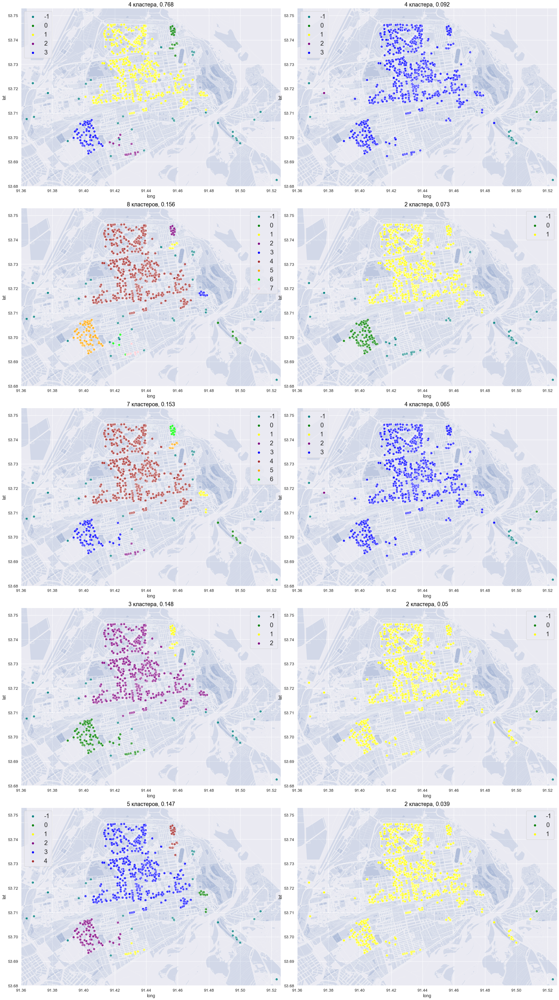

In [70]:
# Лучшие разбиения
for j in [1072, 1313, 1154, 1493, 1014]:
    instance = hdbscan.HDBSCAN(min_samples = int(hdb_variants.loc[j, 'min_samples']), \
                               min_cluster_size = int(hdb_variants.loc[j, 'min_size']), \
                               metric = hdb_variants.loc[j, 'metric'], \
                               gen_min_span_tree = True)
    instance.fit(osm_nonull.loc[:, ['lat', 'long']])
    osm_nonull[f'cl_hdb{j}'] = instance.labels_
for j in [156, 710, 130, 664, 108]:    
    instance1 = hdbscan.HDBSCAN(min_samples = int(hdb_variants.loc[j, 'min_samples']), \
                                min_cluster_size = int(hdb_variants.loc[j, 'min_size']), \
                                metric = hdb_variants.loc[j, 'metric'], \
                                gen_min_span_tree = True)
    
    instance1.fit(data_nonull.loc[:, ['lat', 'long']])
    
    data_nonull[f'cl_hdb{j}'] = instance1.labels_

fig, ax = plt.subplots(nrows = 5, ncols = 2, figsize = (25, 45))
fig.tight_layout()

for i in range(0, 5, 1):
    index_cl = [1072, 1313, 1154, 1493, 1014][i]
    index_cl1 = [156, 710, 130, 664, 108][i]
    n_cl = int(hdb_variants.loc[index_cl, 'n_unique']) - 1
    n_cl1 = int(hdb_variants.loc[index_cl1, 'n_all']) - 1
    score_cl = round(hdb_variants.loc[index_cl, 'score_unique'], 3)
    score_cl1 = round(hdb_variants.loc[index_cl1, 'score_all'], 3)
    
    abakan.plot(alpha = 0.15, edgecolor = 'white', markersize = 0.001, ax = ax[i, 0])
    abakan.plot(alpha = 0.15, edgecolor = 'white', markersize = 0.001, ax = ax[i, 1])
    
    # Левый столбец
    sns.scatterplot(x = osm_nonull.long, y = osm_nonull.lat, hue = osm_nonull[f'cl_hdb{index_cl}'], ax = ax[i, 0],
                    palette = sns.color_palette(colors_s, n_cl + 1), s = 60);
    
    # Правый столбец
    sns.scatterplot(x = data_nonull.long, y = data_nonull.lat, hue = data_nonull[f'cl_hdb{index_cl1}'], ax = ax[i, 1],
                    palette = sns.color_palette(colors_s, n_cl1 + 1), s = 60);
    
    if n_cl < 5:
        ax[i, 0].set_title(f'{n_cl} кластера, {score_cl}', fontsize = 18, color = 'black')
    else:
        ax[i, 0].set_title(f'{n_cl} кластеров, {score_cl}', fontsize = 18, color = 'black')
    ax[i, 0].set_xlim(91.36, 91.526)
    ax[i, 0].set_ylim(53.68, 53.753)
    ax[i, 0].set_aspect(1/math.cos(math.radians(50.0)))
    ax[i, 0].legend(fontsize = 20)
    
    if n_cl1 < 5:
        ax[i, 1].set_title(f'{n_cl1} кластера, {score_cl1}', fontsize = 18, color = 'black')
    else:
        ax[i, 1].set_title(f'{n_cl1} кластеров, {score_cl1}', fontsize = 18, color = 'black')
    ax[i, 1].set_xlim(91.36, 91.526)
    ax[i, 1].set_ylim(53.68, 53.753)
    ax[i, 1].set_aspect(1/math.cos(math.radians(50.0)))
    ax[i, 1].legend(fontsize = 20)
plt.show()

Как можно заметить, взглянув на представленные графики, **HDBSCAN** не очень хочет разделять центральное скопление точек, предпочитая разбивать на подклассы иные зоны с меньшим число адресов. А если все-таки разбивает, то на чрезвычайно большой набор кластеров (что можно увидеть на графике ниже, синим на нем помечен шум), что опять же, вероятно, сводится к домам со значительным числом объявлений. 

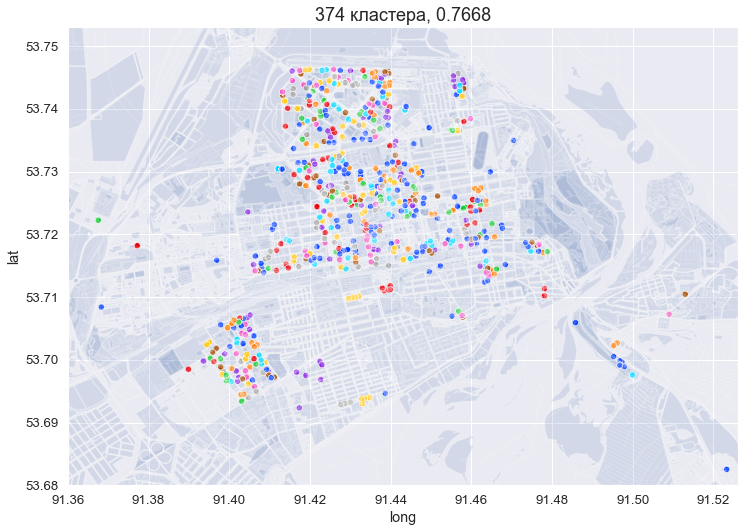

In [71]:
instance1 = hdbscan.HDBSCAN(min_samples = int(hdb_variants.loc[1089, 'min_samples']), \
                            min_cluster_size = int(hdb_variants.loc[1089, 'min_size']), \
                            metric = hdb_variants.loc[1089, 'metric'], \
                            gen_min_span_tree = True)

instance1.fit(data_nonull.loc[:, ['lat', 'long']])

fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = (12, 10))
abakan.plot(alpha = 0.15, edgecolor = 'white', markersize = 0.001, ax = ax)
sns.scatterplot(x = data_nonull.long, y = data_nonull.lat, hue = instance1.labels_, ax = ax, palette = 'bright', \
                legend = False);
ax.set_aspect(1/math.cos(math.radians(50.0)))
ax.set_xlim(91.36, 91.526)
ax.set_ylim(53.68, 53.753)
ax.set_title(f'{374} кластера, {0.7668}', fontsize = 18)
plt.show()

Судя по полученным результатам, наблюдается некоторый трейдофф между числом кластеров и числом выбросов: чем больше одних, тем меньше других. Не уверен, характерно ли это для данного алгоритма в целом, или причиной служит сам датасет. В целом складывается впечатление, что <br> **k-means** справляется с задачей лучше, находя большее число уникальных кластеров, даже несмотря на то, что некоторые из них не всегда отличаются по ценам.

Кажется, что проверять на полученных кластерах гипотезы о разницы цен на большинстве разбиений не имеет смысла, так как мы ранее наблюдали, что центральный кластер значимо отличается от выделенного юго-западного (левый нижний угол), который в сво очередь значимо делится на два подкластера.

Проверим однако несколько гипотез для двух северо-восточных районов (верхний правый угол), которые, например, помечены цифрами **1** **2** на графике для уникальных адресов с разбиением на **8** кластеров.

Оба кластера не отличаются от центрального региона по результатам проверки гипотез (проверяем снова с альтернативной гипотезой о превышении цены центра над остальными, если не отвергается для односторонней альтернативной гипотезы, то точно не отвергнется и для двусторонней), хотя *p-value* второго теста почти дотягивает до уровня значимости 0.05.

In [72]:
print(scipy.stats.ttest_ind(data_nonull.loc[data_nonull.apply(lambda x: (x[['lat', 'long']] == \
osm_nonull.loc[osm_nonull[f'cl_hdb1313'] == 1, ['lat', 'long']]).any(), axis = 1).any(axis = 1), 'price'], \
data_nonull.loc[data_nonull.apply(lambda x: (x[['lat', 'long']] == \
osm_nonull.loc[osm_nonull[f'cl_hdb1313'] == 4, ['lat', 'long']]).any(), axis = 1).any(axis = 1), 'price'], \
equal_var = False, alternative = 'less'))

print(scipy.stats.ttest_ind(data_nonull.loc[data_nonull.apply(lambda x: (x[['lat', 'long']] == \
osm_nonull.loc[osm_nonull[f'cl_hdb1313'] == 2, ['lat', 'long']]).any(), axis = 1).any(axis = 1), 'price'], \
data_nonull.loc[data_nonull.apply(lambda x: (x[['lat', 'long']] == \
osm_nonull.loc[osm_nonull[f'cl_hdb1313'] == 4, ['lat', 'long']]).any(), axis = 1).any(axis = 1), 'price'], \
equal_var = False, alternative = 'less'))

Ttest_indResult(statistic=-1.171811363929797, pvalue=0.12342893475377209)
Ttest_indResult(statistic=-1.6821359504055085, pvalue=0.05201917544199813)


Более того, гипотеза о равенстве цен  не отвергается для **2** и **4** кластеров, говорить о том, что их разделение является правильным по результатам сравнения цен, нельзя.

In [73]:
scipy.stats.ttest_ind(data_nonull.loc[data_nonull.apply(lambda x: (x[['lat', 'long']] == \
osm_nonull.loc[osm_nonull[f'cl_hdb1313'] == 1, ['lat', 'long']]).any(), axis = 1).any(axis = 1), 'price'], \
data_nonull.loc[data_nonull.apply(lambda x: (x[['lat', 'long']] == \
osm_nonull.loc[osm_nonull[f'cl_hdb1313'] == 2, ['lat', 'long']]).any(), axis = 1).any(axis = 1), 'price'], \
equal_var = False, alternative = 'two-sided')

Ttest_indResult(statistic=0.6786379046551453, pvalue=0.500367923183092)

Как было сказано ранее, **k-means** предоставляет больше различных многокластерных разделений карты по сравнению с **HDBCSAN**, так что если какие-то разбиения и будут использованы при оценивании моделей в следующем ноутбуке (поскольку на данный момент оценки получены с помощью всех предоставленных данных без учета разбиений на тренировочную и тестовую части, использовать их нельзя из-за очевидного лика), то это, скорее, те, что получены с помощью предпоследнего.

## Результат

На выход имеем датесет со всеми наблюдениями и готовым географическими признаками.

In [74]:
data_full.to_csv('data3.csv')

## Чего не хватает этому ноутбуку

* Крутых визуализаций. С картами можно придумать кучу разных интересных графиков, например, добавить слайдеры, при изменении которых на карте отображаются только квартиры с определенным количеством комнат/дома определенной этажности/квартиры определенной ценовой категории и т.д., прикрутить к карте статистики, которые будут высвечиваться при наведении на них курсора, замастить кластеризацию гексагонами, чтобы районы соединилясь определенным образом и создавали красивую визуализацию и еще много-много всего. В общем, простор для улучшения большой, добавить некоторые из этих штук сходу у меня не получилось (здесь не особо помогал огромный датасет карты города, который солидно нагружал процессор и оперативку).


* Еще больше алгоритмов кластеризации. Я ожидал, что HDBSCAN сможет значительно улучшить разбиения по сравнению с k-means, но этого не произошло (возможно, что-то можно поменять внутри него, но я много чего перепробовал, и ничего из этого не привело к заметному улучшению, из оставшегося можно посмотреть на вероятности того, когда алгоритм начинает относить точку к шуму), вполне вероятно, что стоило попробовать и другие алгоритмы кластеризации, например, Spectral Clustering, или попытаться кластеризовать не только по координатам, например, добавляя больше признаков и сокращая размерности при помощи PCA (что однако не являлось целью данного ноутбука).


* Адекватного фреймворка проверки гипотез. Просто печатать отвергнутые/не отвергнутые гипотезы не очень здорово, такое представление немного (а может и много) ухудшает восприятие происходящего, но ничего иного быстро реализовываемого я придумать не смог. Здесь опять же большой потенциал модификации, можно построить какие-то графы с p-value на ребрах, засунуть результаты в датафреймы и как-то покрутить их, написать человеческие классы, в которых бы проходило и обучение алгоритмов, и проверка большого числа самых разных гипотез для самых разных данных.


* Как обычно, оптимально написанного кода. Уверен, что ряд вещей здесь написаны далеко не так, как стоило бы (особенно меня смущаются части со сравнениями геометрических объектов). Повезло, что данных не много и модельки обучались очень быстро, так что даже удалось покрутить что-то у HDBSCAN-а, а дольше всего строились картинки с данными по городу (часть из этих данных, скорее всего, можно было даже выкинуть за ненадобностью без изменений в отрисовке карты).